In [1]:
%load_ext lab_black
%matplotlib inline

In [2]:
from glob import glob
import numpy as np
import os
from pathlib import Path
import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from cartopy.mpl.geoaxes import GeoAxes
from pyresample.geometry import AreaDefinition

import matplotlib.pyplot as plt
from matplotlib.axes import Axes
import matplotlib.colors
from matplotlib import cm
from satpy.scene import Scene
import warnings

from datetime import datetime
import pandas as pd
import geopandas as gpd


GeoAxes._pcolormesh_patched = Axes.pcolormesh
warnings.filterwarnings("ignore")

In [3]:
# File to be downloaded here: https://data.eumetsat.int/extended?query=High%20Rate%20SEVIRI%20Level%201.5%20Image%20Data%20-%20MSG%20-%200%20degree#
nat_file = "MSG3-SEVI-MSG15-0100-NA-20221109105740.782000000Z-NA.nat"

In [4]:
scn = Scene(reader="seviri_l1b_native", filenames=[nat_file])
scn

In [5]:
scn.load(["natural_color"], upper_right_corner="NE")

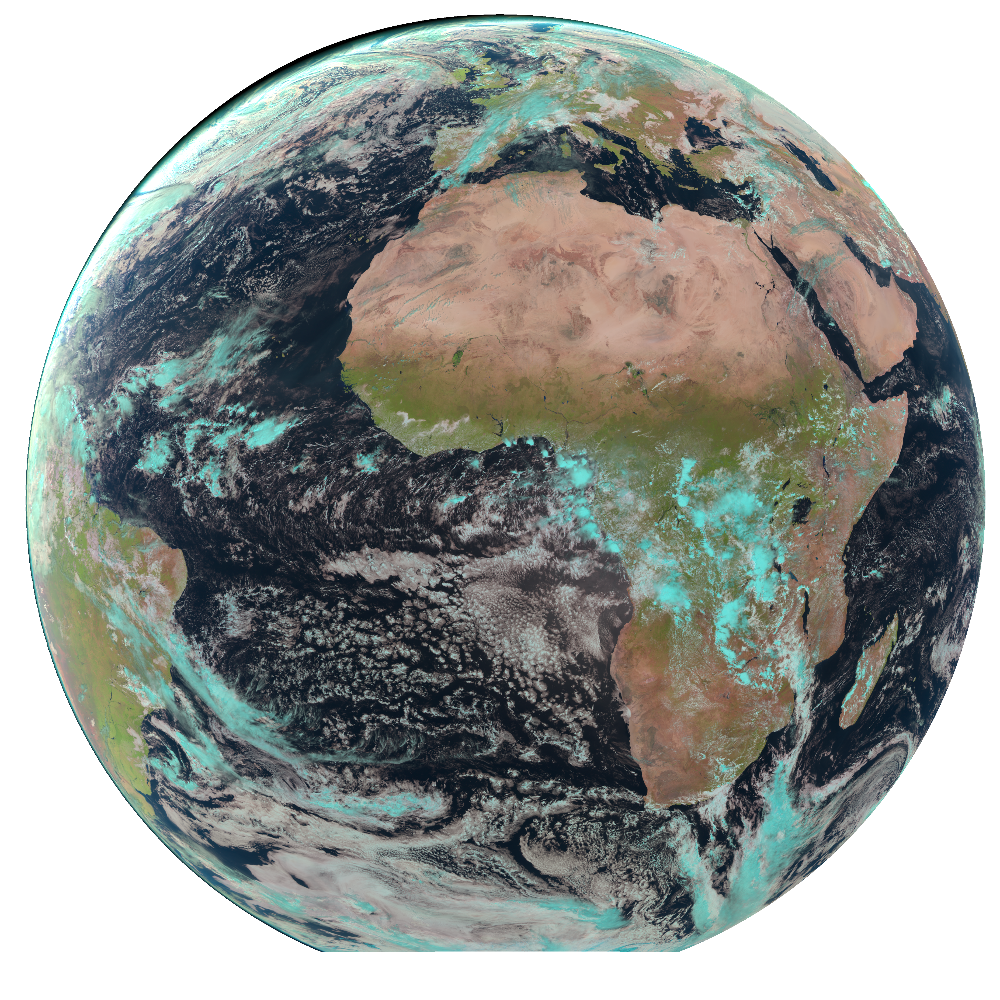

In [6]:
scn.show("natural_color")

In [7]:
from shapely.geometry import Point

points = [
    Point(1.44367, 43.60426),
]
gdf = gpd.GeoDataFrame(["Me"], geometry=points, crs="epsg:4326")

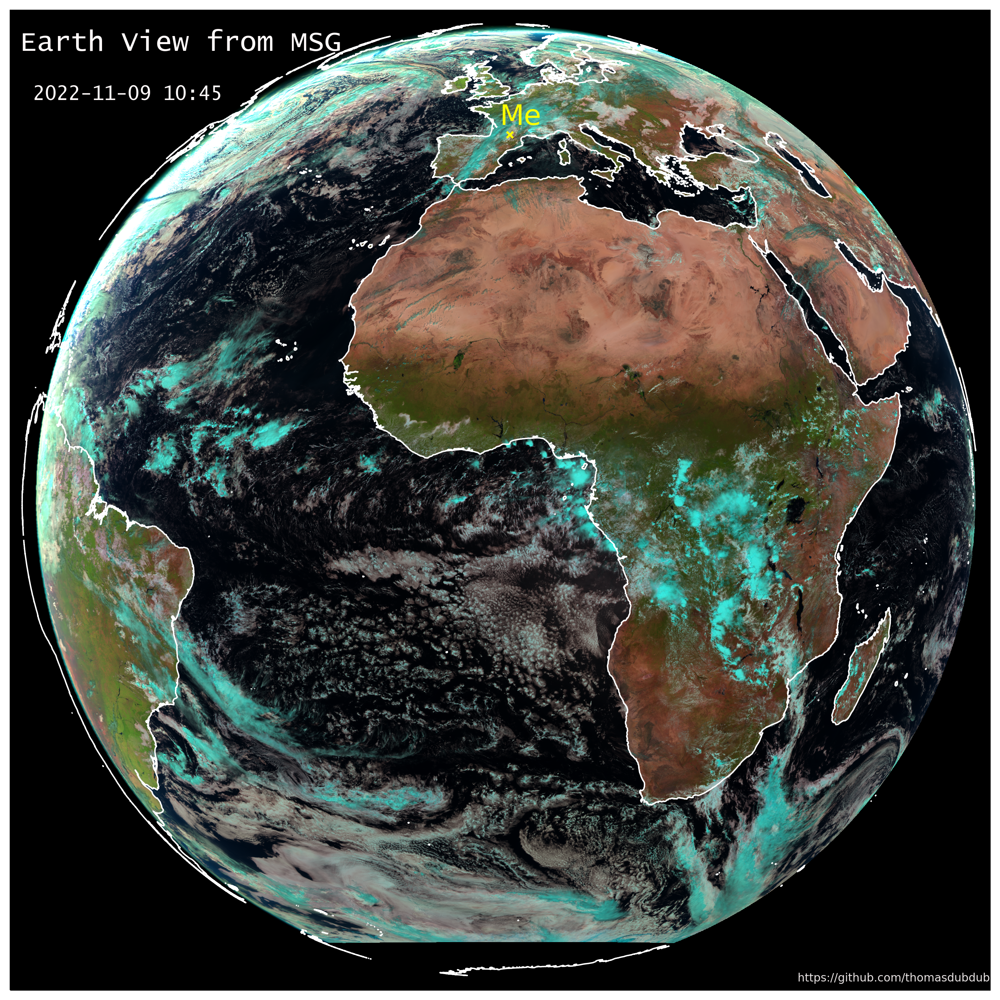

In [8]:
image = np.asarray(scn["natural_color"]).transpose(1, 2, 0)
image = np.interp(
    image, (np.nanpercentile(image, 1), np.nanpercentile(image, 99)), (0, 1)
)
fig = plt.figure(figsize=(10, 10), dpi=300)
crs = scn["natural_color"].attrs["area"].to_cartopy_crs()
gdf_proj = gdf.to_crs(crs)
ax = fig.add_subplot(1, 1, 1, projection=crs)
ax.coastlines(resolution="10m", color="white", linewidth=1.0)
ax.imshow(image, transform=crs, extent=crs.bounds, origin="upper", cmap="Greys_r")
gdf_proj.plot(ax=ax, color="yellow", marker="x", markersize=20)
for x, y, label in zip(
    gdf_proj.geometry.x,
    gdf_proj.geometry.y,
    gdf_proj[0],
):
    ax.annotate(
        label,
        xy=(x, y),
        xytext=(-7, 7),
        textcoords="offset points",
        size=20.0,
        color="yellow",
    )
plt.title(
    "Earth View from MSG at "
    + scn["natural_color"].attrs["start_time"].strftime("%Y-%m-%d %H:%M"),
    fontname="Lucida Sans Unicode",
    fontsize=15,
)

plt.title(
    "Earth View from MSG",
    fontsize=20,
    fontname="Lucida Console",
    y=0.95,
    color="snow",
    x=0.010,
    loc="left",
)
plt.title(
    scn["natural_color"].attrs["start_time"].strftime("%Y-%m-%d %H:%M"),
    fontsize=14,
    fontname="Lucida Console",
    y=0.90,
    color="snow",
    x=0.12,
)
plt.title(
    "https://github.com/thomasdubdub",
    fontsize=8,
    color="snow",
    alpha=0.9,
    y=0.00,
    loc="right",
)
plt.tight_layout()
plt.savefig("space.png", dpi=300, bbox_inches="tight", pad_inches=0)